In [1]:
### Imports

import os
from pathlib import Path
from rosbags.highlevel import AnyReader
from rosbags.image import message_to_cvimage
from rosbags.typesys import Stores, get_typestore
import numpy as np
import cv2
import matplotlib.pyplot as plt
import glob
import random
import matplotlib.image as mpimg
from IPython.display import display, Markdown
import math
import matplotlib.patches as patches
from collections import defaultdict
from matplotlib import colormaps

In [16]:
### Functions to extract images and poses from bag files *********************************

def extract_poses_from_bag(bags_root, bag_name, bag_path, task_output_root, pose_file_name):
    
    pose_output_path = os.path.join(task_output_root, pose_file_name)
    bagpath = Path(bag_path)
    typestore = get_typestore(Stores.ROS1_NOETIC)

    with AnyReader([bagpath], default_typestore=typestore) as reader, open(pose_output_path, 'w') as pose_output_file:
        # Write header
        header = "timestamp x y theta\n"
        pose_output_file.write(header)

        # Find the connection for the topic
        connections = [x for x in reader.connections if x.topic == "/amcl_pose"]

        for connection, timestamp, rawdata in reader.messages(connections=connections):
            msg = reader.deserialize(rawdata, connection.msgtype)
            # Use attribute access instead of dictionary access
            t = int(timestamp / 1e9)  # nanoseconds to seconds
            pos = msg.pose.pose.position
            ori = msg.pose.pose.orientation
            line = f"{t} {pos.x:.5f} {pos.y:.5f} {ori.z:.5f}\n"
            pose_output_file.write(line)
    #print("Pose extraction completed.")

def extract_images_from_bag(bags_root, bag_name, bag_path, task_output_root):
    from pathlib import Path
    from rosbags.highlevel import AnyReader
    from rosbags.typesys import Stores, get_typestore

    bagpath = Path(bag_path)
    typestore = get_typestore(Stores.ROS1_NOETIC)

    topic_suffixes = {
        '/realsense_torso_front_camera/color/image_raw_throttle': '_t',
        '/realsense_front_camera/color/image_raw_throttle': '_f',
        '/realsense_left_camera/color/image_raw_throttle': '_l',
        '/realsense_right_camera/color/image_raw_throttle': '_r'
    }

    with AnyReader([bagpath], default_typestore=typestore) as reader:
        connections = [x for x in reader.connections if x.topic in topic_suffixes]
        for connection, timestamp, rawdata in reader.messages(connections=connections):
            msg = reader.deserialize(rawdata, connection.msgtype)
            # Convert ROS image message to OpenCV image
            img = message_to_cvimage(msg, 'bgr8')
            t = int(timestamp / 1e9)  # nanoseconds to seconds
            suffix = topic_suffixes[connection.topic]
            img_name = f"{t}{suffix}.jpg"
            img_output_path = os.path.join(task_output_root, img_name)
            cv2.imwrite(img_output_path, img)
    #print("Image extraction completed.")
    
def extract_imu_from_bag(bags_root, bag_name, bag_path, task_output_root, imu_file_name):
    import os
    from pathlib import Path

    imu_output_path = os.path.join(task_output_root, imu_file_name)
    bagpath = Path(bag_path)
    typestore = get_typestore(Stores.ROS1_NOETIC)

    with AnyReader([bagpath], default_typestore=typestore) as reader, open(imu_output_path, 'w') as imu_output_file:
        header = "timestamp orientation_x orientation_y orientation_z orientation_w angular_vel_x angular_vel_y angular_vel_z linear_acc_x linear_acc_y linear_acc_z\n"
        imu_output_file.write(header)
        connections = [x for x in reader.connections if x.topic == "/smart_wheel_driver/pdb/imu"]

        for connection, timestamp, rawdata in reader.messages(connections=connections):
            msg = reader.deserialize(rawdata, connection.msgtype)
            t = int(timestamp / 1e9)  # nanoseconds to seconds
            ori = msg.orientation
            ang = msg.angular_velocity
            lin = msg.linear_acceleration
            line = (
                f"{t} "
                f"{ori.x:.6f} {ori.y:.6f} {ori.z:.6f} {ori.w:.6f} "
                f"{ang.x:.6f} {ang.y:.6f} {ang.z:.6f} "
                f"{lin.x:.6f} {lin.y:.6f} {lin.z:.6f}\n"
            )
            imu_output_file.write(line)
    #print("IMU extraction completed.")

In [3]:
### Functions to average poses to match camera frames ************************************

def avg_poses(dataset_root, pose_file_name, avg_pose_file_name):
    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if pose_file_name in filenames:
            task_pose_file_path = os.path.join(dirpath, pose_file_name)
            task_avg_pose_file_path = os.path.join(dirpath, avg_pose_file_name)
            process_poses_file(task_pose_file_path, task_avg_pose_file_path)
            
def process_poses_file(task_pose_file_path, task_avg_pose_file_path):
    # Dictionary: timestamp -> list of [x, y, z]
    poses_dict = {}
    with open(task_pose_file_path, 'r') as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            timestamp = tokens[0]
            values = [float(tokens[1]), float(tokens[2]), float(tokens[3])]
            poses_dict.setdefault(timestamp, []).append(values)
    # Calculate averages and write to output
    with open(task_avg_pose_file_path, 'w') as f:
        f.write("timestamp x y theta\n")
        for timestamp in sorted(poses_dict.keys()):
            arr = np.array(poses_dict[timestamp])
            avg = arr.mean(axis=0)
            f.write(f"{timestamp} {avg[0]:.5f} {avg[1]:.5f} {avg[2]:.5f}\n")

In [4]:
### Functions to output image pose and place pairs ***************************************

def parse_poses_file(poses_path):
    poses = {}
    with open(poses_path, "r") as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            timestamp = tokens[0]
            position = [float(tokens[1]), float(tokens[2]), float(tokens[3])]
            poses[timestamp] = position
    return poses

def timestamp_from_filename(filename):
    base = os.path.basename(filename)
    return base.split('_')[0]

def merge_images_and_poses(dataset_root, avg_pose_file_name, output_file):
    rows = []
    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if avg_pose_file_name in filenames:
            poses_path = os.path.join(dirpath, avg_pose_file_name)
            poses = parse_poses_file(poses_path)
            images = glob.glob(os.path.join(dirpath, "*.jpg"))
            for img in images:
                ts = timestamp_from_filename(img)
                if ts in poses:
                    rel_img_path = os.path.relpath(img, dataset_root)
                    x, y, theta = poses[ts]
                    rows.append(f"{rel_img_path} {x} {y} {theta}")
                    
    with open(output_file, "w") as f:
        f.write("image_path x y theta\n")
        for row in rows:
            f.write(row + "\n")

In [5]:
### Functions to filter images based on their brightness *********************************

def compute_brightness(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return None
    return img.mean()
    
def is_valid_image(file_path, min_brightness, max_brightness):
    if not os.path.exists(file_path):
        return False
    img = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return False
    mean_brightness = img.mean()
    return min_brightness <= mean_brightness <= max_brightness
    
def filter_images(dataset_root, file_path, filtered_file_path, min_brightness, max_brightness, image_col_index=0, delimiter=' '):
    with open(file_path, 'r') as infile, open(filtered_file_path, 'w') as outfile:
        outfile.write("timestamp x y theta\n")
        for line in infile:
            parts = line.strip().split(delimiter)
            if len(parts) <= image_col_index:
                continue
            rel_path = parts[image_col_index]
            full_path = os.path.join(dataset_root, rel_path)
            if is_valid_image(full_path, min_brightness, max_brightness):
                outfile.write(line)

def plot_brightness(dataset_root, file_path, image_col_index=0, delimiter=' '):
    brightness_values = []
    with open(file_path, 'r') as file:
        for line in file:
            parts = line.strip().split(delimiter)
            if len(parts) <= image_col_index:
                continue

            rel_path = parts[image_col_index]
            full_path = os.path.join(dataset_root, rel_path)
            if not os.path.exists(full_path):
                continue

            brightness = compute_brightness(full_path)
            if brightness is not None:
                brightness_values.append(brightness)
                
    plt.hist(brightness_values, bins=50, color='skyblue', edgecolor='black')
    plt.title("Image Brightness Distribution")
    plt.xlabel("Mean Brightness (0 = dark, 255 = bright)")
    plt.ylabel("Number of Images")
    plt.grid(True)
    plt.show()  
    return brightness_values

def count_suffixes(file_path):
    suffix_map = {
        '_t': 'Torso',
        '_f': 'Front',
        '_r': 'Right',
        '_l': 'Left'
    }
    counts = {group: 0 for group in suffix_map.values()}
    row_count = 0  # Initialize row counter
    
    with open(file_path, 'r') as f:
        for line in f:
            columns = line.strip().split()
            if not columns:
                continue
            row_count += 1  # Increment for each non-empty row
            image_path = columns[0]
            filename = os.path.basename(image_path)
            name, ext = os.path.splitext(filename)
            for suf, group in suffix_map.items():
                if name.endswith(suf):
                    counts[group] += 1
                    break
    return counts, row_count

def plot_pie(counts):
    labels = []
    sizes = []
    for k, v in counts.items():
        if v > 0:
            labels.append(k)
            sizes.append(v)
    if not sizes:
        print("No images with the expected suffixes were found. Nothing to plot.")
        return
    plt.figure(figsize=(3, 3))
    plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140)
    plt.title('Distribution of Camera Samples')
    plt.axis('equal')
    plt.show()

In [6]:
### Functions to generate place_id for each grid cell and plot them **********************
### Functions to plot poses **************************************************************

def generate_place_ids(input_file, output_file, grid_size, has_header=True):
    place_id_map = {}
    next_place_id = 0
    output_lines = []

    with open(input_file, 'r') as infile:
        lines = infile.readlines()

    # Optionally skip header
    start_idx = 1 if has_header else 0
    data_lines = lines[start_idx:]

    for line_num, line in enumerate(data_lines, start=start_idx + 1):
        if not line.strip():
            continue  # skip empty lines

        parts = line.strip().split()
        if len(parts) != 4:
            print(f"Skipping malformed line {line_num}: {line.strip()}")
            continue

        image_path, x_str, y_str, theta_str = parts
        try:
            x = float(x_str)
            y = float(y_str)
        except ValueError:
            print(f"Skipping line with non-numeric coordinates at line {line_num}")
            continue

        # Compute grid cell
        grid_x = math.floor(x / grid_size)
        grid_y = math.floor(y / grid_size)
        grid_key = (grid_x, grid_y)

        # Assign place_id
        if grid_key not in place_id_map:
            place_id_map[grid_key] = next_place_id
            next_place_id += 1

        place_id = place_id_map[grid_key]
        output_lines.append(f"{image_path} {x} {y} {theta_str} {place_id}\n")

    with open(output_file, 'w') as outfile:
        if has_header:
            outfile.write("image_path x y theta place_id\n")
        outfile.writelines(output_lines)

    print(f"Processed {len(output_lines)} entries with {next_place_id} unique place_ids.")

def plot_place_ids(input_file, grid_size, fig_width=25, fig_height=4, dpi=200):
    data = []

    with open(input_file, 'r') as f:
        lines = f.readlines()

    # Skip header if present
    if lines[0].strip().startswith("image_path"):
        lines = lines[1:]

    for line in lines:
        parts = line.strip().split()
        if len(parts) != 5:
            continue

        _, x_str, y_str, _, place_id_str = parts
        try:
            x = float(x_str)
            y = float(y_str)
            place_id = int(place_id_str)
        except ValueError:
            continue

        data.append((x, y, place_id))

    # Setup figure
    fig, ax = plt.subplots(figsize=(fig_width, fig_height), dpi=dpi)

    # Scatter all points in gray
    xs = [x for x, _, _ in data]
    ys = [y for _, y, _ in data]
    ax.scatter(xs, ys, color='gray', s=1, alpha=0.5)

    # Draw grid borders and place_id labels
    seen_cells = set()
    for x, y, place_id in data:
        grid_x = math.floor(x / grid_size)
        grid_y = math.floor(y / grid_size)
        cell_key = (grid_x, grid_y)

        if cell_key in seen_cells:
            continue
        seen_cells.add(cell_key)

        # Draw border rectangle
        rect = patches.Rectangle(
            (grid_x * grid_size, grid_y * grid_size),
            grid_size,
            grid_size,
            linewidth=1,
            edgecolor='black',
            facecolor='none'
        )
        ax.add_patch(rect)

        # Label place_id at the center of the cell
        center_x = (grid_x + 0.5) * grid_size
        center_y = (grid_y + 0.5) * grid_size
        ax.text(center_x, center_y, str(place_id),
                fontsize=8, ha='center', va='center', alpha=0.4)

    # Axis limits and formatting
    margin = grid_size * 0.5
    ax.set_xlim(min(xs) - margin, max(xs) + margin)
    ax.set_ylim(min(ys) - margin, max(ys) + margin)
    ax.set_aspect('equal')
    ax.set_xlabel("X", fontsize=12)
    ax.set_ylabel("Y", fontsize=12)
    ax.set_title("Grid Cells with Place IDs", fontsize=14)
    ax.grid(True, linestyle="--", alpha=0.3)
    plt.axis('equal')
    plt.tight_layout()
    plt.show()

def read_poses_avg(file_path):
    xs, ys, zs = [], [], []
    with open(file_path, 'r') as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            xs.append(float(tokens[1]))
            ys.append(float(tokens[2]))
            zs.append(float(tokens[3]))
    return np.array(xs), np.array(ys), np.array(zs)

def plot_orientations(xs, ys, zs, color, label, scale=0.5):
    plt.plot(xs, ys, marker='o', color=color, label=label)
    for x, y, z in zip(xs, ys, zs):
        dx = scale * np.cos(z)
        dy = scale * np.sin(z)
        plt.arrow(x, y, dx, dy, head_width=0.1, head_length=0.1, fc=color, ec=color, alpha=0.6)

def plot_poses(dataset_root, avg_pose_file_name, fig_width=25, fig_height=4, dpi=200):
    plt.figure(figsize=(fig_width, fig_height))
    color_cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']
    color_idx = 0

    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if avg_pose_file_name in filenames:
            file_path = os.path.join(dirpath, avg_pose_file_name)
            xs, ys, zs = read_poses_avg(file_path)
            label = os.path.relpath(dirpath, dataset_root)
            color = color_cycle[color_idx % len(color_cycle)]
            plot_orientations(xs, ys, zs, color, label)
            color_idx += 1

    plt.xlabel("X")
    plt.ylabel("Y")
    plt.title("Overlayed Average Poses from All Tasks")
    #plt.legend()
    plt.axis('equal')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.close()

In [7]:
### Functions to create the ground truth *************************************************

def get_suffix(path):
    filename = os.path.basename(path)
    return filename.split('_')[-1].split('.')[0]  # e.g., 'r'

def get_folder(path):
    return path.split('/')[0]  # task_id

def get_timestamp(path):
    filename = os.path.basename(path)
    ts_str = filename.split('_')[0]
    return int(ts_str)

def generate_triplets_by_pose(text_file_path, camera_matching, task_matching, date_matching, POSITIVE_DISTANCE_THRESHOLD, NEGATIVE_DISTANCE_THRESHOLD):
    # Load data
    all_images = []
    with open(text_file_path, 'r') as f:
        for line in f:
            if not line.strip() or line.startswith("image_path"):
                continue
            parts = line.strip().split()
            img_path, x, y, theta, place_id = parts[0], float(parts[1]), float(parts[2]), float(parts[3]), parts[4]
            all_images.append({
                "path": img_path,
                "position": np.array([x, y]),
                "theta": theta,
                "place_id": place_id,
                "folder": get_folder(img_path),
                "suffix": get_suffix(img_path),
                "timestamp": get_timestamp(img_path),
                "day": get_timestamp(img_path) // 86400,
            })

    # Convert to numpy arrays for fast filtering
    positions = np.array([img["position"] for img in all_images])
    paths = np.array([img["path"] for img in all_images])
    suffixes = np.array([img["suffix"] for img in all_images])
    folders = np.array([img["folder"] for img in all_images])
    timestamps = np.array([img["timestamp"] for img in all_images])
    days = np.array([img["day"] for img in all_images])

    triplets = []

    for i, anchor in enumerate(all_images):
        anchor_pos = anchor["position"]
        anchor_path = anchor["path"]
        anchor_suffix = anchor["suffix"]
        anchor_folder = anchor["folder"]
        anchor_day = anchor["day"]

        # === Apply candidate mask ===
        mask = np.ones(len(all_images), dtype=bool)
        mask[i] = False  # exclude self

        if camera_matching:
            mask &= (suffixes == anchor_suffix)
        else:
            mask &= (suffixes != anchor_suffix)

        if task_matching:
            mask &= (folders == anchor_folder)
        else:
            mask &= (folders != anchor_folder)

        if date_matching:
            mask &= (days == anchor_day)
        else:
            mask &= (days != anchor_day)

        candidate_idx = np.where(mask)[0]
        if len(candidate_idx) == 0:
            continue

        candidate_positions = positions[candidate_idx]
        dists = np.linalg.norm(candidate_positions - anchor_pos, axis=1)

        pos_mask = (dists > 0) & (dists <= POSITIVE_DISTANCE_THRESHOLD)
        neg_mask = (dists >= NEGATIVE_DISTANCE_THRESHOLD)

        pos_candidates = paths[candidate_idx[pos_mask]]
        neg_candidates = paths[candidate_idx[neg_mask]]

        if len(pos_candidates) > 0 and len(neg_candidates) > 0:
            pos_path = random.choice(pos_candidates)
            neg_path = random.choice(neg_candidates)
            triplets.append((anchor_path, pos_path, neg_path))

    return triplets

def generate_triplets_by_place(text_file_path, camera_matching, task_matching, date_matching):
    # Load data
    all_images = []
    with open(text_file_path, 'r') as f:
        for line in f:
            if not line.strip() or line.startswith("image_path"):
                continue
            parts = line.strip().split()
            img_path, x, y, theta, place_id = parts[0], float(parts[1]), float(parts[2]), float(parts[3]), parts[4]
            all_images.append({
                "path": img_path,
                "place_id": place_id,
                "folder": get_folder(img_path),
                "suffix": get_suffix(img_path),
                "timestamp": get_timestamp(img_path),
                "day": get_timestamp(img_path) // 86400,
            })

    # Precompute arrays
    paths = np.array([img["path"] for img in all_images])
    place_ids = np.array([img["place_id"] for img in all_images])
    folders = np.array([img["folder"] for img in all_images])
    suffixes = np.array([img["suffix"] for img in all_images])
    days = np.array([img["day"] for img in all_images])

    triplets = []

    for i, anchor in enumerate(all_images):
        anchor_path = anchor["path"]
        anchor_place = anchor["place_id"]
        anchor_suffix = anchor["suffix"]
        anchor_folder = anchor["folder"]
        anchor_day = anchor["day"]

        # === Build mask for all candidates ===
        mask = np.ones(len(all_images), dtype=bool)
        mask[i] = False  # exclude self

        if camera_matching:
            mask &= (suffixes == anchor_suffix)
        else:
            mask &= (suffixes != anchor_suffix)

        if task_matching:
            mask &= (folders == anchor_folder)
        else:
            mask &= (folders != anchor_folder)

        if date_matching:
            mask &= (days == anchor_day)
        else:
            mask &= (days != anchor_day)

        candidate_idx = np.where(mask)[0]
        if len(candidate_idx) == 0:
            continue

        # Partition into positive (same place) and negative (different place)
        pos_idx = candidate_idx[place_ids[candidate_idx] == anchor_place]
        neg_idx = candidate_idx[place_ids[candidate_idx] != anchor_place]

        if len(pos_idx) > 0 and len(neg_idx) > 0:
            pos_path = random.choice(paths[pos_idx])
            neg_path = random.choice(paths[neg_idx])
            triplets.append((anchor_path, pos_path, neg_path))

    return triplets

In [17]:
### Adjust the params ********************************************************************

bags_root = '/home/jovyan/data/VPR/LW_bags/All'
dataset_root = '/home/jovyan/data/VPR/LW'

avg_pose_file_name = "poses_avg.txt"
pose_file_name = "poses.txt"
imu_file_name = "imu.txt"

image_pose_path = os.path.join(dataset_root, "image_pose.txt")
filtered_image_pose_path = os.path.join(dataset_root, "filtered_image_pose.txt")
image_pose_place_path = os.path.join(dataset_root, "image_pose_place.txt")
gt_path = os.path.join(dataset_root, "gt.txt")



In [18]:
### Bag extraction ***********************************************************************

for bag_name in os.listdir(bags_root):
    if bag_name.endswith('.bag'):
        bag_name_noext, ext = os.path.splitext(bag_name)
        short_bag_name = bag_name_noext[:41]
        bag_path = os.path.join(bags_root, bag_name)
        # print(f"Processing {bag_path}")
        task_output_root = os.path.join(dataset_root, short_bag_name)
        os.makedirs(task_output_root, exist_ok=True)
        #extract_images_from_bag(bags_root, bag_name, bag_path, task_output_root)
        #extract_poses_from_bag(bags_root, bag_name, bag_path, task_output_root, pose_file_name)
        extract_imu_from_bag(bags_root, bag_name, bag_path, task_output_root, imu_file_name)

print("Finished bag file extraction")

Finished bag file extraction


In [10]:
### Pose average *************************************************************************

avg_poses(dataset_root, pose_file_name, avg_pose_file_name)
print("Finished pose averaging")

Finished pose averaging


In [11]:
### Merge images and poses ***************************************************************

merge_images_and_poses(dataset_root, avg_pose_file_name, image_pose_path)
print("Finished image pose merging")

Finished image pose merging


Before filtering: 136,034


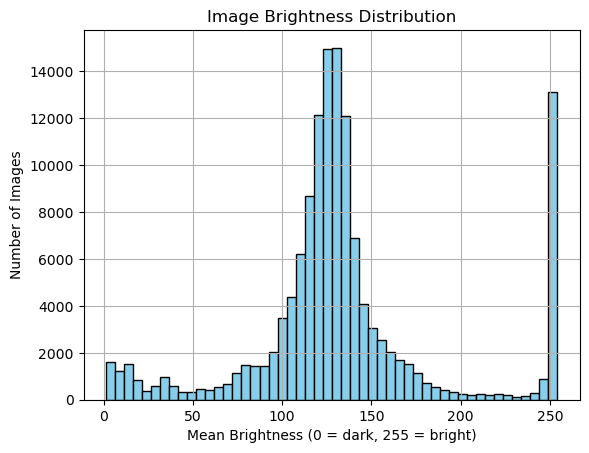

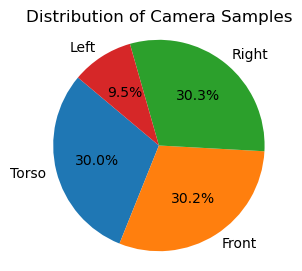

Filtering in progress
Finished image filtering
After filtering: 130,592


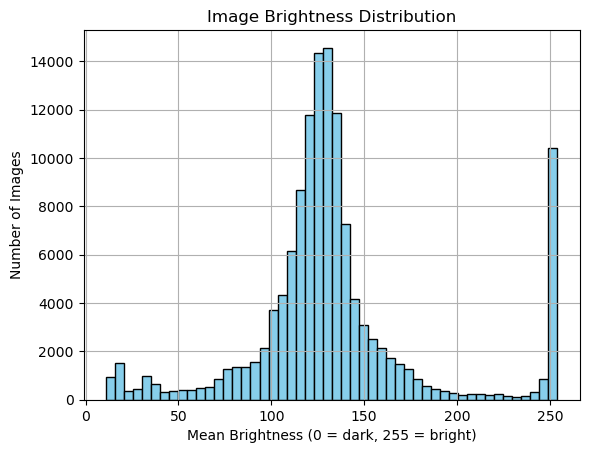

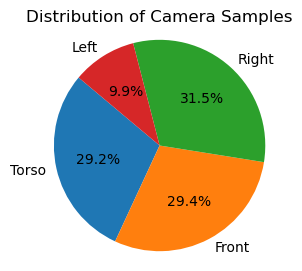

In [12]:
### Image filter *************************************************************************

counts, row_count = count_suffixes(image_pose_path)
print("Before filtering: {:,}".format(row_count))
brightness_values = plot_brightness(dataset_root, image_pose_path)
plot_pie(counts)

brightness_mean = np.mean(brightness_values) 
brightness_std = np.std(brightness_values)

# First option using mean and std
#min_brightness = brightness_mean-2*brightness_std
#max_brightness = brightness_mean+2*brightness_std

# Second option using percentile is more robust to outliers 
# This keeps 96% of the images and trims 2% from each tail 
min_brightness = np.percentile(brightness_values, 2)
max_brightness = np.percentile(brightness_values, 98)

print("Filtering in progress")
filter_images(dataset_root, image_pose_path, filtered_image_pose_path, min_brightness, max_brightness)
print("Finished image filtering")

counts, row_count = count_suffixes(filtered_image_pose_path)
print("After filtering: {:,}".format(row_count))
plot_brightness(dataset_root, filtered_image_pose_path)
plot_pie(counts)


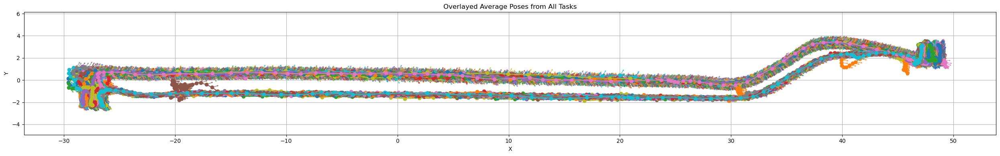

Processed 130591 entries with 38 unique place_ids.
Finished generating place_ids


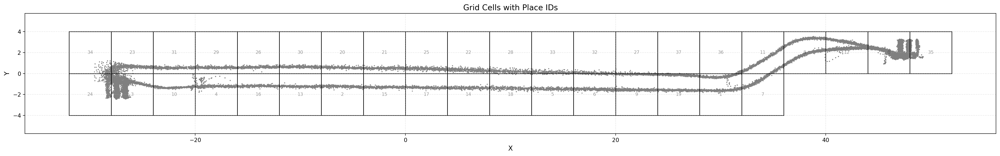

In [13]:
### Plot poses and places ****************************************************************

GRID_SIZE = 4

plot_poses(dataset_root, avg_pose_file_name)
generate_place_ids(filtered_image_pose_path, image_pose_place_path, GRID_SIZE, has_header=True)
print("Finished generating place_ids")
plot_place_ids(image_pose_place_path, GRID_SIZE)

In [14]:
### Ground truth generation **************************************************************

camera_matching = True
task_matching = False
date_matching = True

POSITIVE_DISTANCE_THRESHOLD = 2
NEGATIVE_DISTANCE_THRESHOLD = 10.0

triplets = generate_triplets_by_pose(image_pose_place_path, camera_matching, task_matching, date_matching, POSITIVE_DISTANCE_THRESHOLD, NEGATIVE_DISTANCE_THRESHOLD)
#triplets = generate_triplets_by_place(image_pose_place_path, camera_matching, task_matching, date_matching)

with open(gt_path, "w") as f:
    f.write("anchor positive negative\n")
    for anchor, positive, negative in triplets:
        f.write(f"{anchor} {positive} {negative}\n")

print("Finished ground truth generation")


Finished ground truth generation


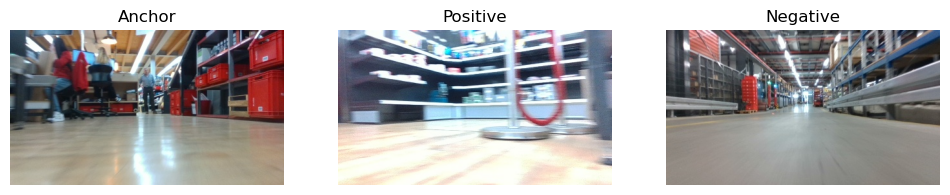

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920130_f.jpg`  
**Positive:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747921977_f.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913862_f.jpg`

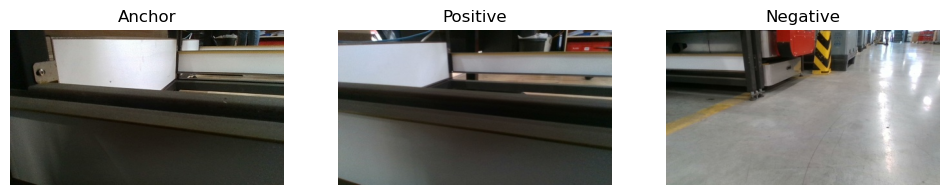

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920173_r.jpg`  
**Positive:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922695_r.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913674_r.jpg`

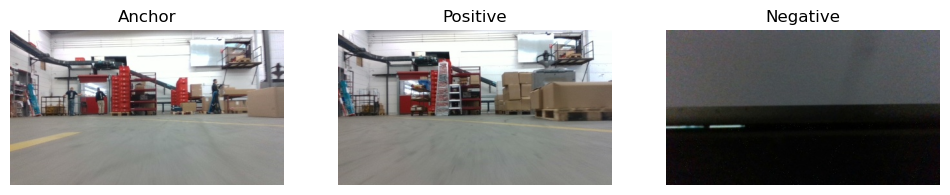

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920111_f.jpg`  
**Positive:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925223_f.jpg`  
**Negative:** `task_b62fe242-ccb6-4741-8ae1-3aed5fd5ec9e/1747920593_f.jpg`

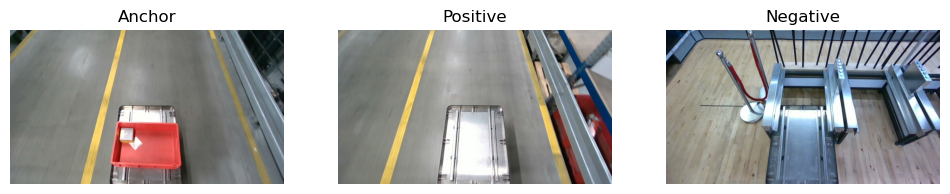

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920089_t.jpg`  
**Positive:** `task_8bfa2ca9-bf8c-4ef0-b034-d1240ec5d5d0/1747920835_t.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913771_t.jpg`

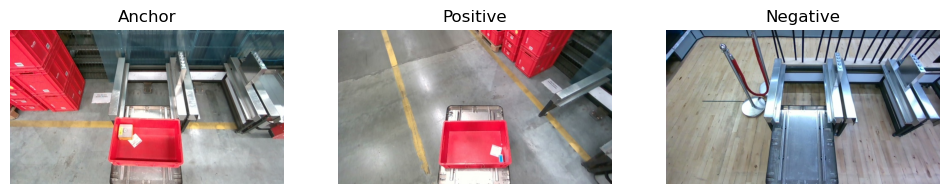

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920055_t.jpg`  
**Positive:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922607_t.jpg`  
**Negative:** `task_b60ddbdb-adbc-432a-abcc-b1311a542b20/1747920370_t.jpg`

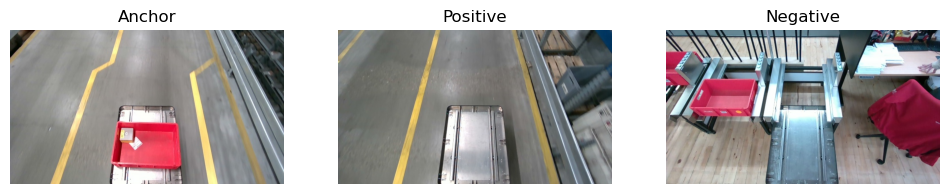

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920082_t.jpg`  
**Positive:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910177_t.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910105_t.jpg`

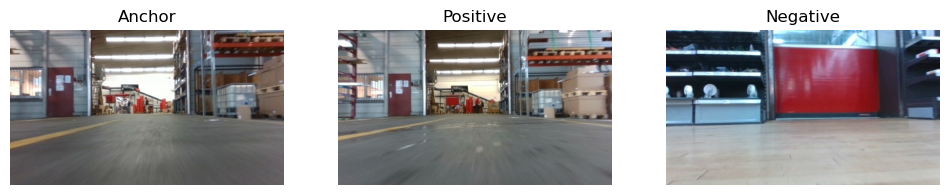

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920102_f.jpg`  
**Positive:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922637_f.jpg`  
**Negative:** `task_bb4203bd-524f-45de-bdbc-2d7f46ba7e09/1747904100_f.jpg`

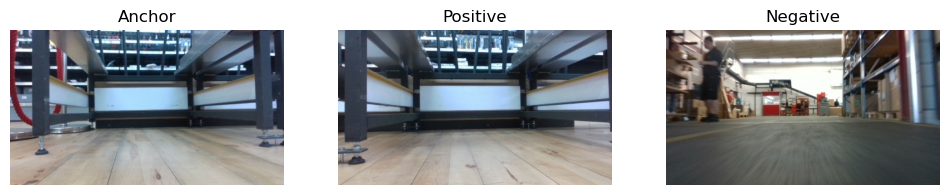

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920161_f.jpg`  
**Positive:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747904050_f.jpg`  
**Negative:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897573_f.jpg`

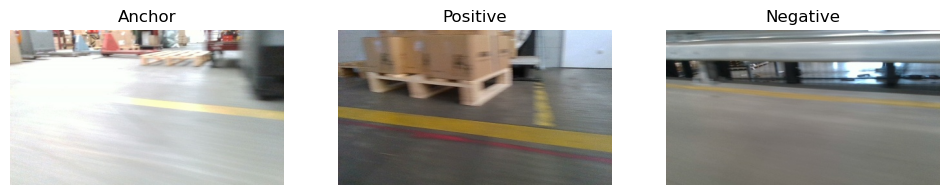

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920111_r.jpg`  
**Positive:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925344_r.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913694_r.jpg`

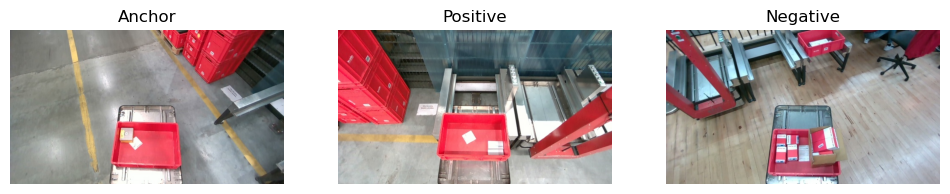

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920073_t.jpg`  
**Positive:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925153_t.jpg`  
**Negative:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897624_t.jpg`

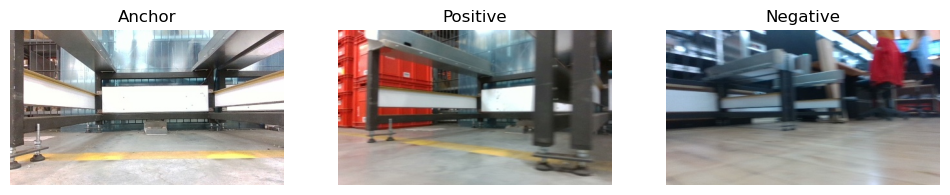

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920060_f.jpg`  
**Positive:** `task_9fa09cb8-3b76-4c46-9bcb-314575aa9506/1747894628_f.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919587_f.jpg`

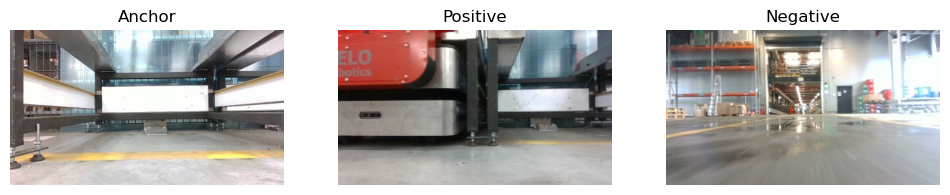

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920061_f.jpg`  
**Positive:** `task_32e918ee-c6c1-4b59-b744-e77f9649b964/1747897081_f.jpg`  
**Negative:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922766_f.jpg`

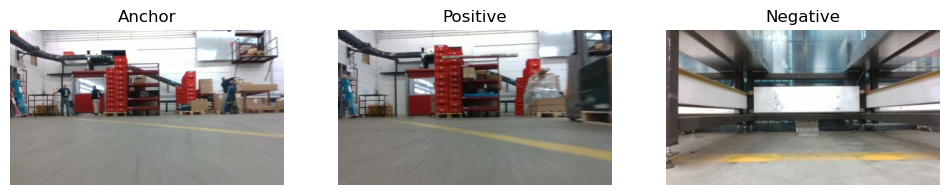

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920112_f.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747910016_f.jpg`  
**Negative:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909958_f.jpg`

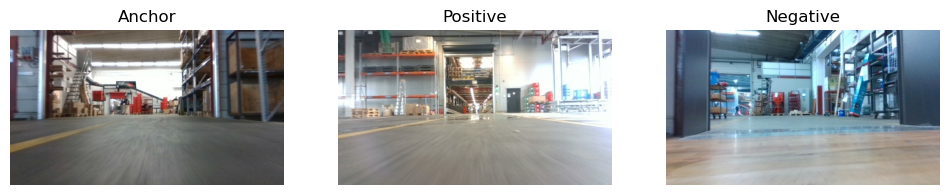

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920104_f.jpg`  
**Positive:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922765_f.jpg`  
**Negative:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747921984_f.jpg`

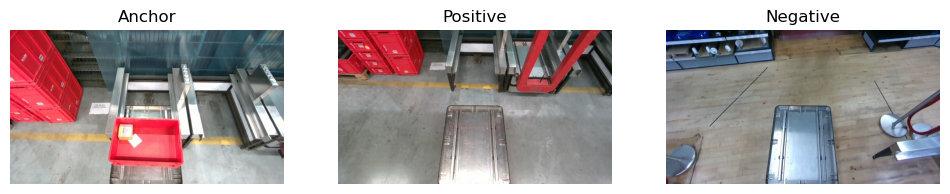

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920052_t.jpg`  
**Positive:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747922052_t.jpg`  
**Negative:** `task_bb4203bd-524f-45de-bdbc-2d7f46ba7e09/1747904102_t.jpg`

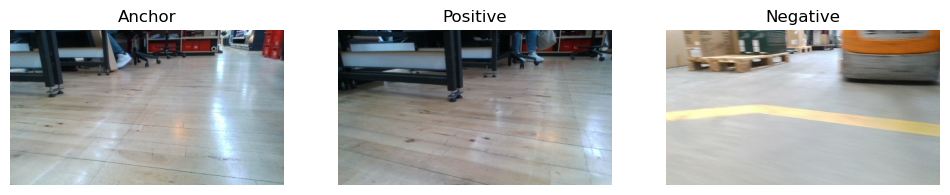

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920143_r.jpg`  
**Positive:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913766_r.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913720_r.jpg`

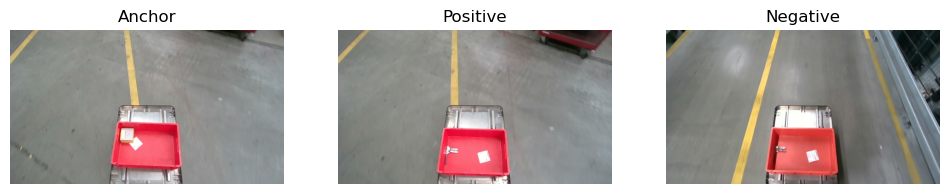

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920115_t.jpg`  
**Positive:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913724_t.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913696_t.jpg`

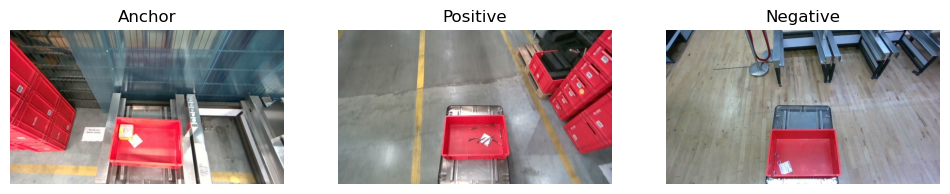

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920048_t.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921835_t.jpg`  
**Negative:** `task_9fa09cb8-3b76-4c46-9bcb-314575aa9506/1747894706_t.jpg`

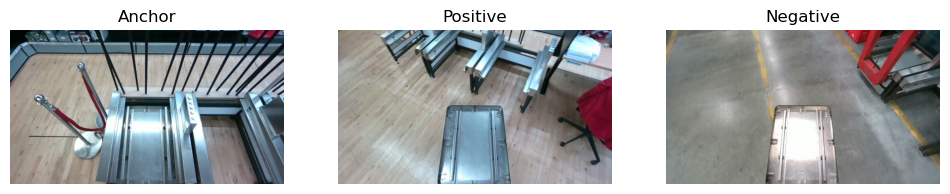

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920173_t.jpg`  
**Positive:** `task_32e918ee-c6c1-4b59-b744-e77f9649b964/1747897000_t.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913880_t.jpg`

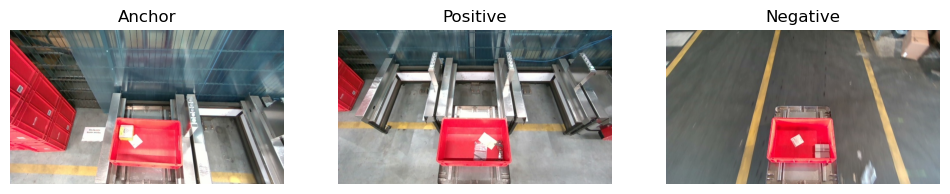

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920043_t.jpg`  
**Positive:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747903948_t.jpg`  
**Negative:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925209_t.jpg`

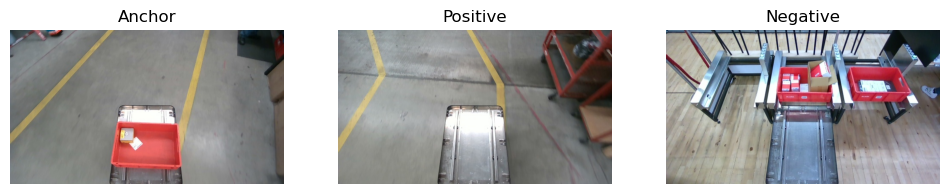

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920120_t.jpg`  
**Positive:** `task_63e09b60-50cb-4edb-b801-dbbc8ed3482c/1747894771_t.jpg`  
**Negative:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897679_t.jpg`

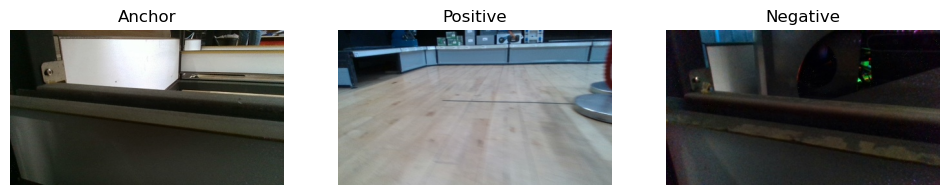

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920174_r.jpg`  
**Positive:** `task_63e09b60-50cb-4edb-b801-dbbc8ed3482c/1747894763_r.jpg`  
**Negative:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922578_r.jpg`

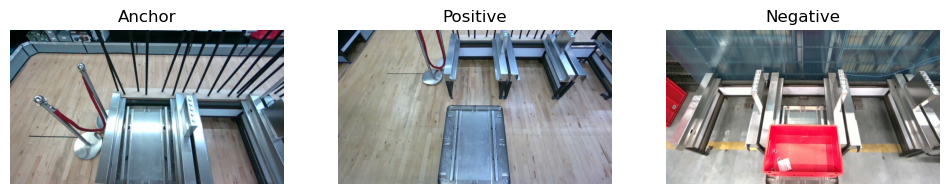

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920177_t.jpg`  
**Positive:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925316_t.jpg`  
**Negative:** `task_9fa09cb8-3b76-4c46-9bcb-314575aa9506/1747894606_t.jpg`

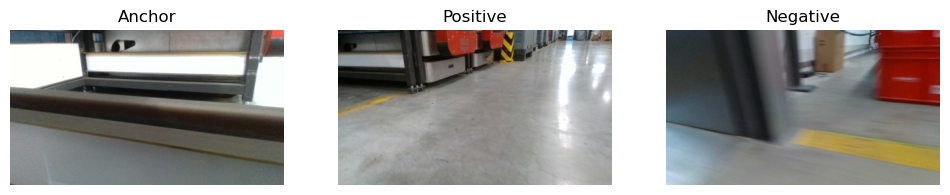

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920053_r.jpg`  
**Positive:** `task_b60ddbdb-adbc-432a-abcc-b1311a542b20/1747920457_r.jpg`  
**Negative:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922666_r.jpg`

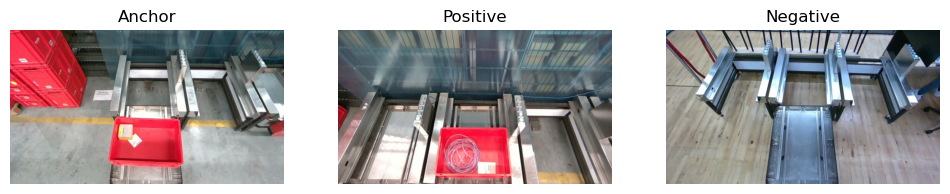

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920056_t.jpg`  
**Positive:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895807_t.jpg`  
**Negative:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747904060_t.jpg`

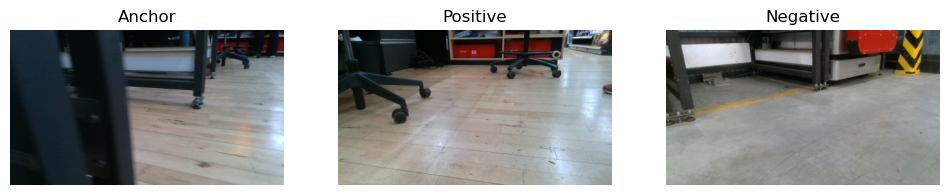

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920167_r.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747910064_r.jpg`  
**Negative:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897757_r.jpg`

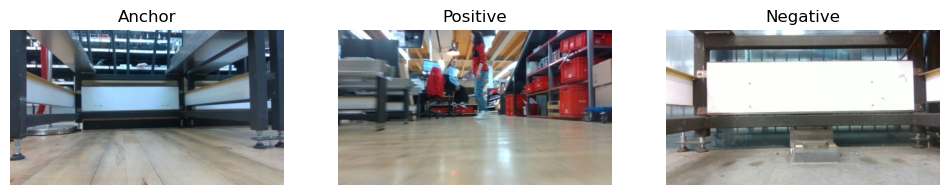

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920139_f.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919574_f.jpg`  
**Negative:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925157_f.jpg`

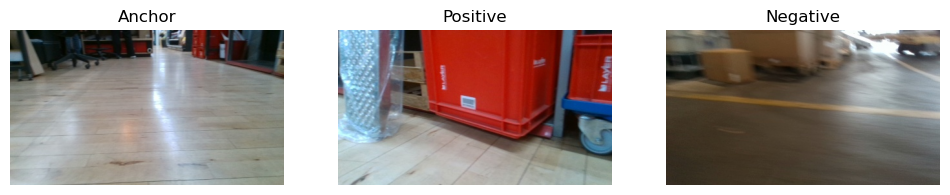

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920157_r.jpg`  
**Positive:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897619_r.jpg`  
**Negative:** `task_b62fe242-ccb6-4741-8ae1-3aed5fd5ec9e/1747920646_r.jpg`

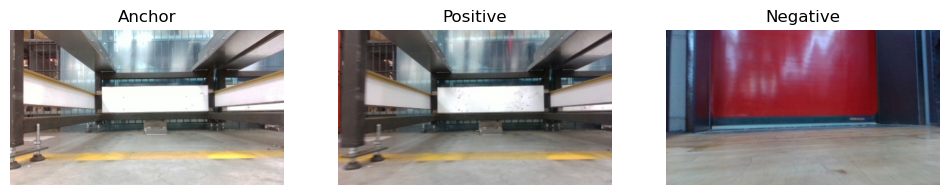

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920062_f.jpg`  
**Positive:** `task_8bfa2ca9-bf8c-4ef0-b034-d1240ec5d5d0/1747920862_f.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910121_f.jpg`

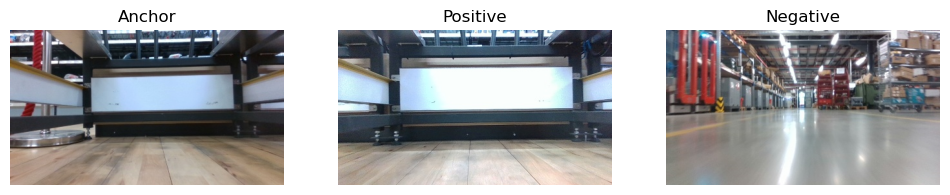

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920166_f.jpg`  
**Positive:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922727_f.jpg`  
**Negative:** `task_b60ddbdb-adbc-432a-abcc-b1311a542b20/1747920440_f.jpg`

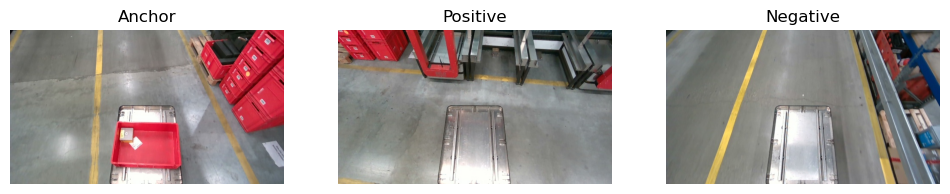

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920076_t.jpg`  
**Positive:** `task_63e09b60-50cb-4edb-b801-dbbc8ed3482c/1747894830_t.jpg`  
**Negative:** `task_8bfa2ca9-bf8c-4ef0-b034-d1240ec5d5d0/1747920838_t.jpg`

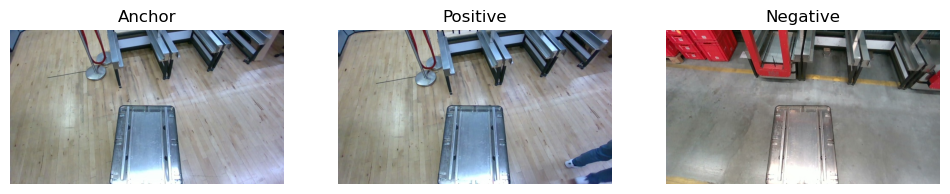

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920150_t.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919599_t.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913885_t.jpg`

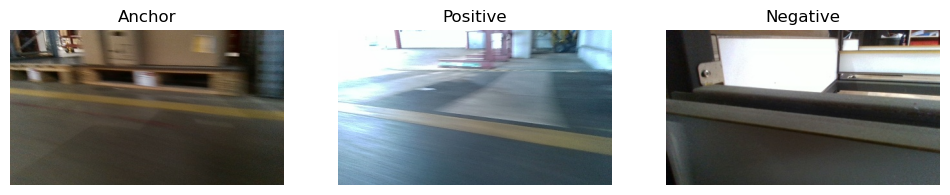

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920107_r.jpg`  
**Positive:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922763_r.jpg`  
**Negative:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925298_r.jpg`

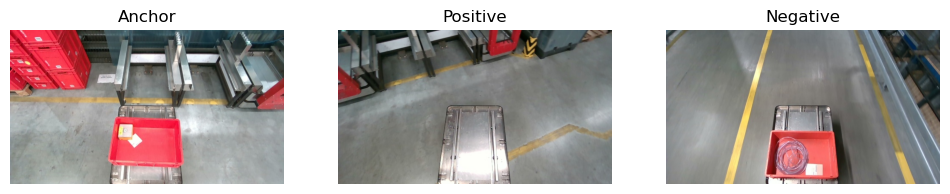

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920058_t.jpg`  
**Positive:** `task_bb4203bd-524f-45de-bdbc-2d7f46ba7e09/1747904165_t.jpg`  
**Negative:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895854_t.jpg`

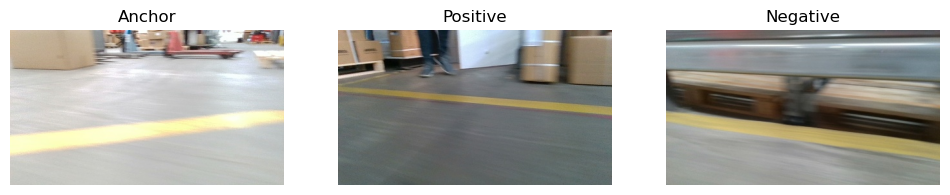

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920112_r.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897707_r.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910178_r.jpg`

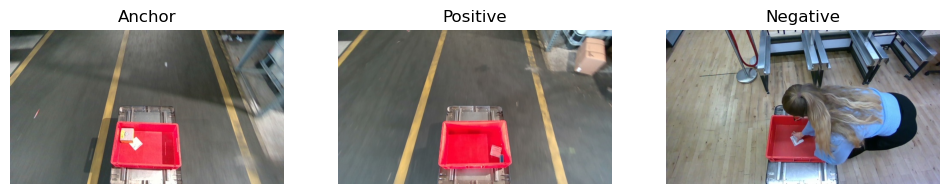

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920105_t.jpg`  
**Positive:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922640_t.jpg`  
**Negative:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925258_t.jpg`

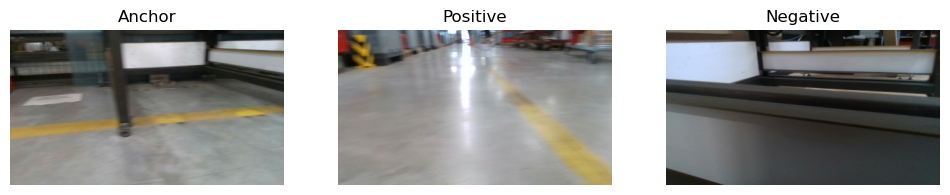

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920072_r.jpg`  
**Positive:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925389_r.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919612_r.jpg`

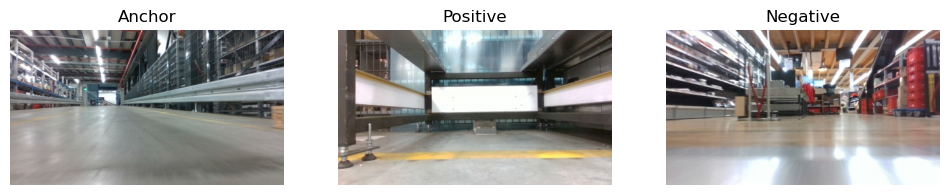

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920077_f.jpg`  
**Positive:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925165_f.jpg`  
**Negative:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925242_f.jpg`

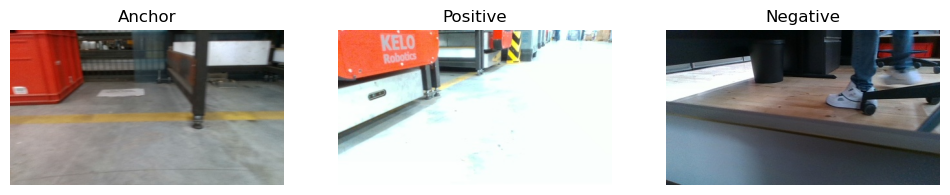

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920073_r.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921818_r.jpg`  
**Negative:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895972_r.jpg`

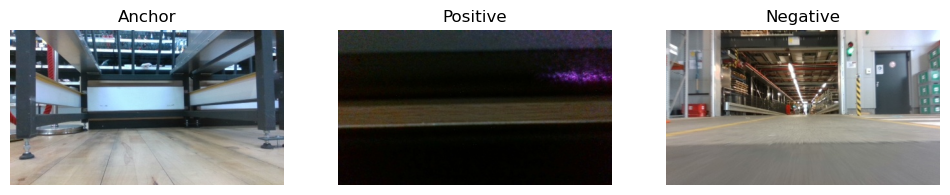

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920148_f.jpg`  
**Positive:** `task_9fa09cb8-3b76-4c46-9bcb-314575aa9506/1747894731_f.jpg`  
**Negative:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925360_f.jpg`

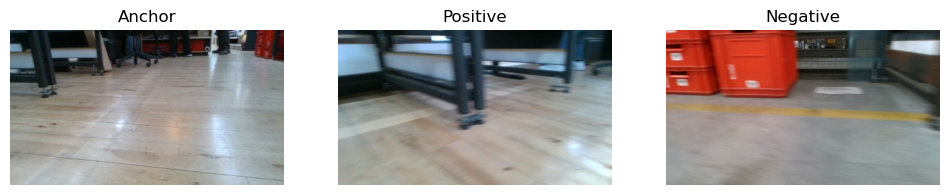

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920153_r.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897685_r.jpg`  
**Negative:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909969_r.jpg`

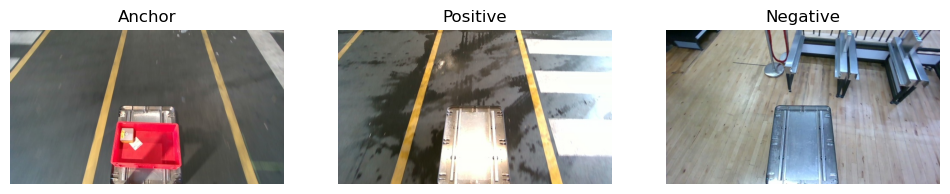

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920102_t.jpg`  
**Positive:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925357_t.jpg`  
**Negative:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925318_t.jpg`

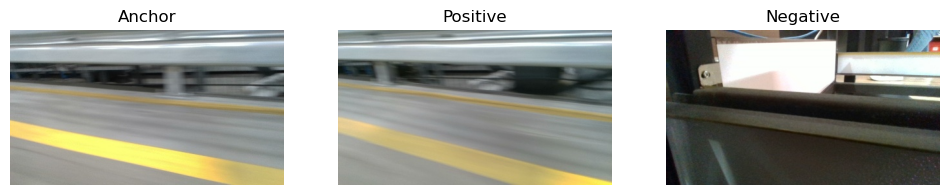

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920081_r.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919523_r.jpg`  
**Negative:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897668_r.jpg`

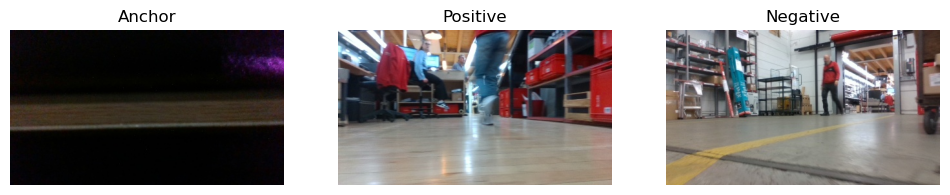

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920177_f.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919582_f.jpg`  
**Negative:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925234_f.jpg`

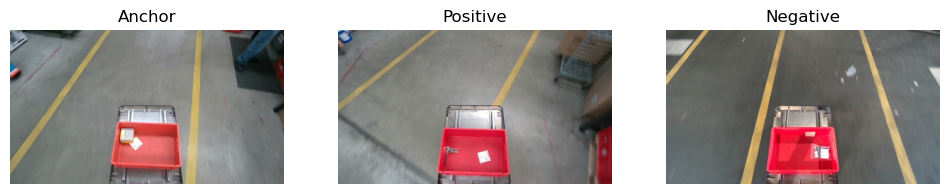

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920121_t.jpg`  
**Positive:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913727_t.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919547_t.jpg`

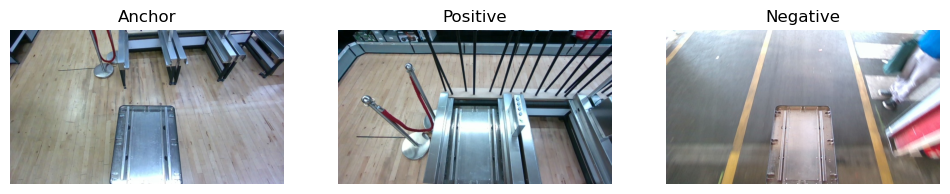

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920149_t.jpg`  
**Positive:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913793_t.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910149_t.jpg`

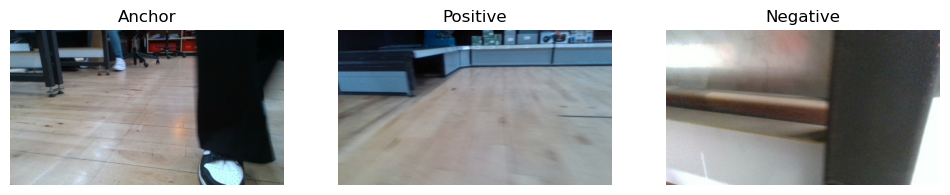

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920138_r.jpg`  
**Positive:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913819_r.jpg`  
**Negative:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922589_r.jpg`

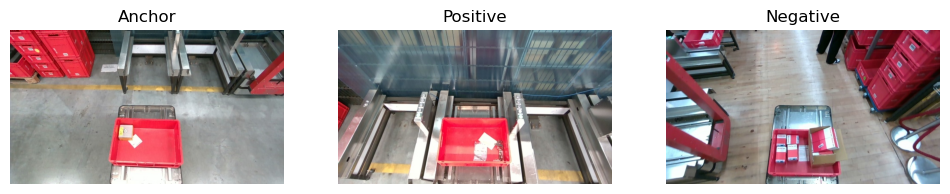

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920063_t.jpg`  
**Positive:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747903942_t.jpg`  
**Negative:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897615_t.jpg`

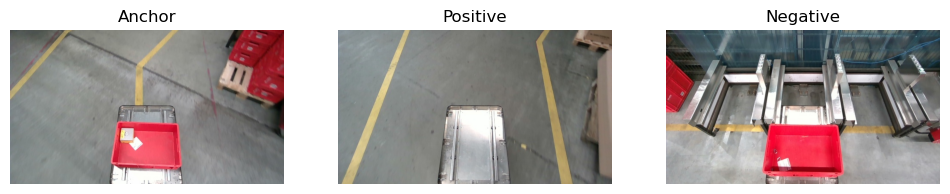

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920117_t.jpg`  
**Positive:** `task_63e09b60-50cb-4edb-b801-dbbc8ed3482c/1747894776_t.jpg`  
**Negative:** `task_9fa09cb8-3b76-4c46-9bcb-314575aa9506/1747894609_t.jpg`

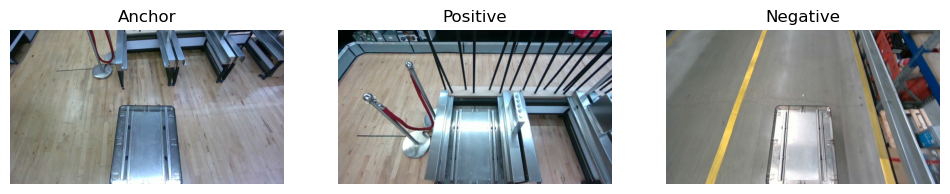

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920154_t.jpg`  
**Positive:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913798_t.jpg`  
**Negative:** `task_8bfa2ca9-bf8c-4ef0-b034-d1240ec5d5d0/1747920838_t.jpg`

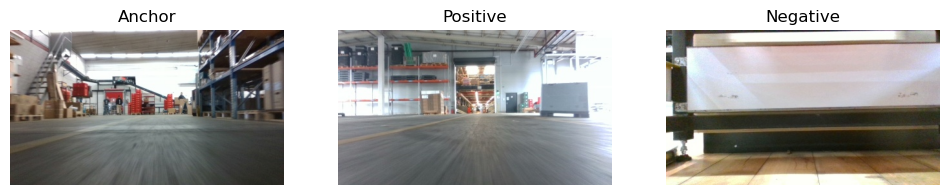

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920106_f.jpg`  
**Positive:** `task_63e09b60-50cb-4edb-b801-dbbc8ed3482c/1747894785_f.jpg`  
**Negative:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747921968_f.jpg`

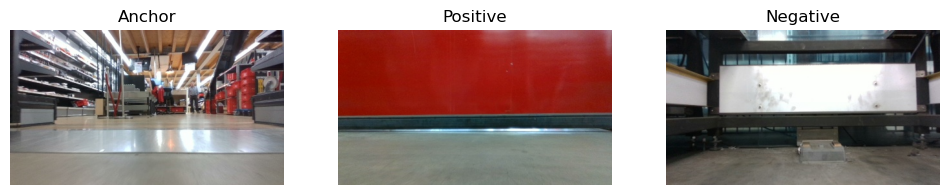

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920125_f.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921889_f.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913892_f.jpg`

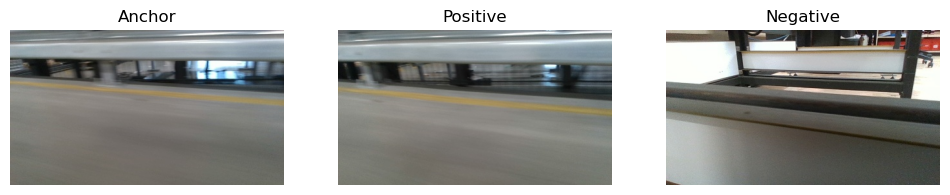

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920087_r.jpg`  
**Positive:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897553_r.jpg`  
**Negative:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925310_r.jpg`

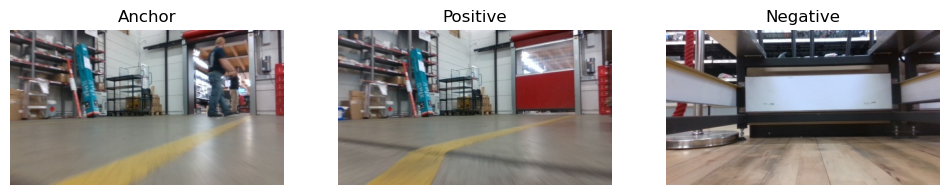

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920118_f.jpg`  
**Positive:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922656_f.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919608_f.jpg`

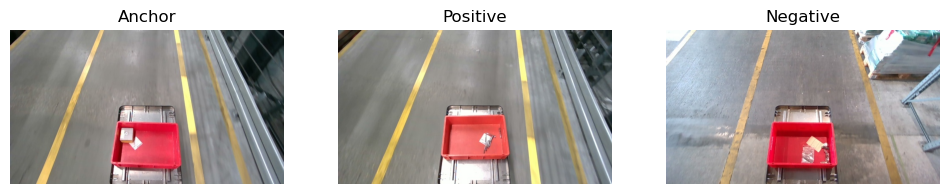

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920080_t.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921839_t.jpg`  
**Negative:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747903989_t.jpg`

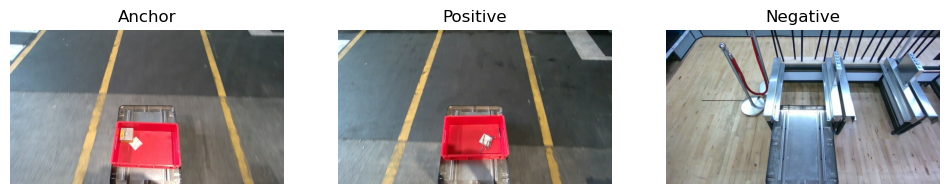

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920097_t.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921857_t.jpg`  
**Negative:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925312_t.jpg`

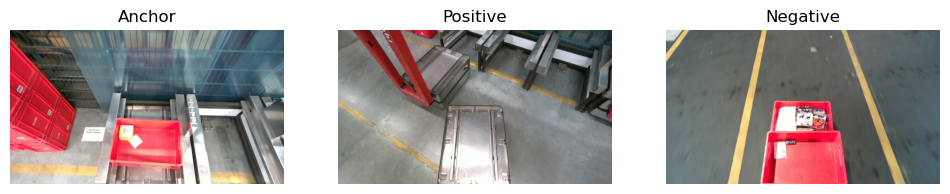

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920042_t.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897757_t.jpg`  
**Negative:** `task_b62fe242-ccb6-4741-8ae1-3aed5fd5ec9e/1747920642_t.jpg`

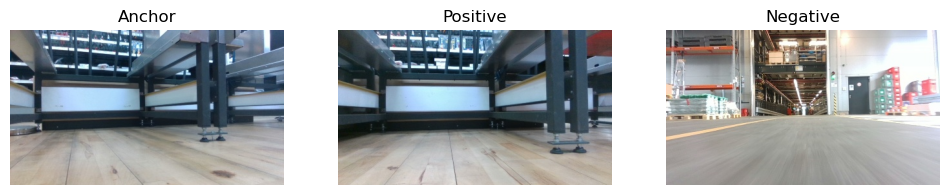

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920151_f.jpg`  
**Positive:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897631_f.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910155_f.jpg`

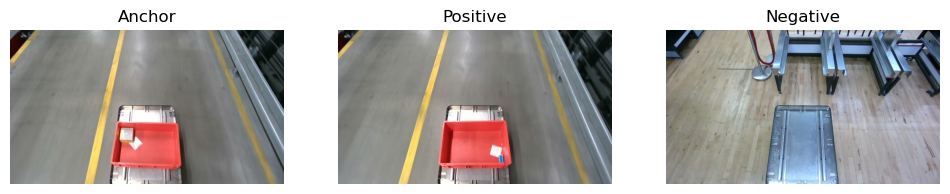

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920087_t.jpg`  
**Positive:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922622_t.jpg`  
**Negative:** `task_b60ddbdb-adbc-432a-abcc-b1311a542b20/1747920376_t.jpg`

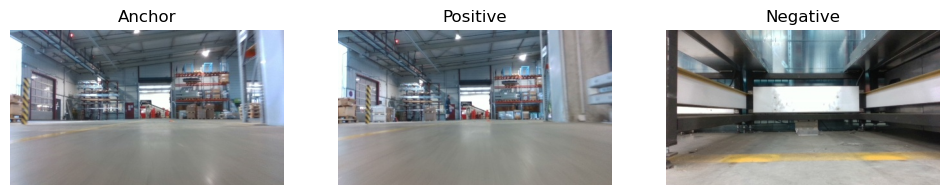

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920093_f.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919536_f.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919509_f.jpg`

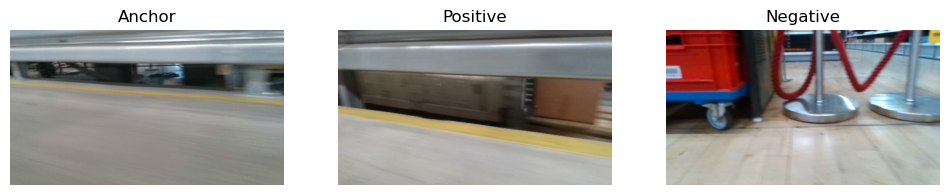

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920085_r.jpg`  
**Positive:** `task_b60ddbdb-adbc-432a-abcc-b1311a542b20/1747920432_r.jpg`  
**Negative:** `task_b62fe242-ccb6-4741-8ae1-3aed5fd5ec9e/1747920674_r.jpg`

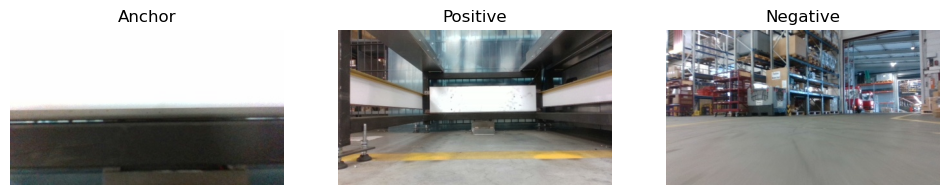

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920050_f.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921827_f.jpg`  
**Negative:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747921995_f.jpg`

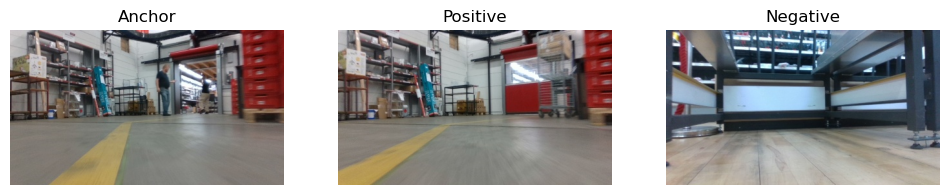

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920116_f.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919561_f.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919599_f.jpg`

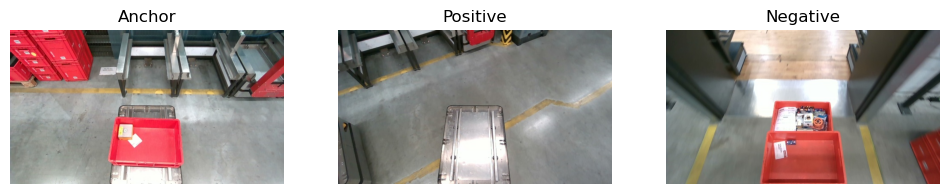

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920059_t.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897750_t.jpg`  
**Negative:** `task_b62fe242-ccb6-4741-8ae1-3aed5fd5ec9e/1747920668_t.jpg`

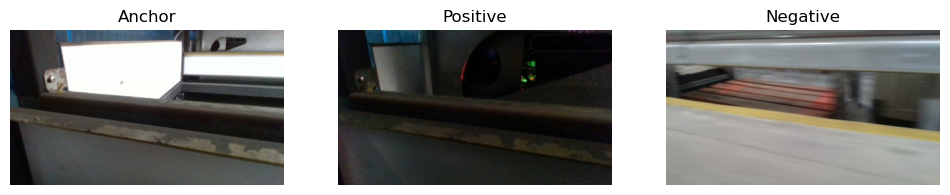

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920045_r.jpg`  
**Positive:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747922064_r.jpg`  
**Negative:** `task_0ccc18af-4c07-422c-b46f-388ccad3d92e/1747919706_r.jpg`

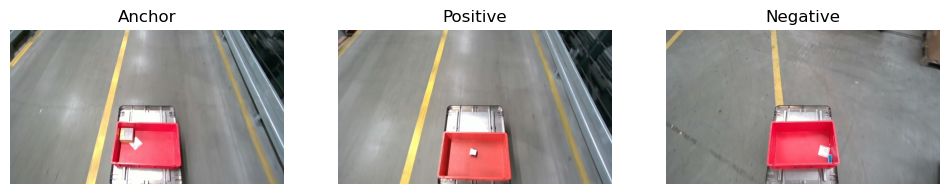

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920085_t.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909979_t.jpg`  
**Negative:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922652_t.jpg`

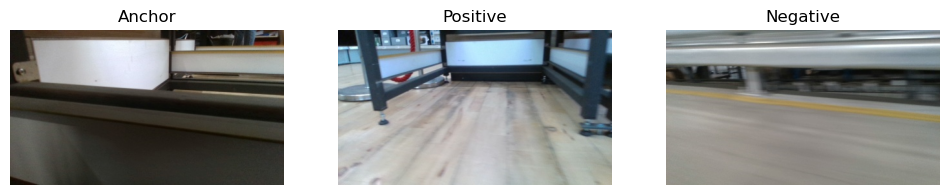

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920172_r.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897689_r.jpg`  
**Negative:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909977_r.jpg`

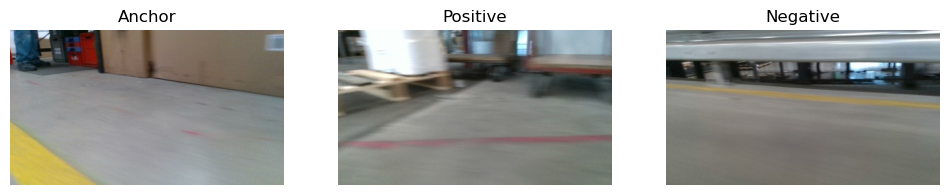

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920120_r.jpg`  
**Positive:** `task_bb4203bd-524f-45de-bdbc-2d7f46ba7e09/1747904113_r.jpg`  
**Negative:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921846_r.jpg`

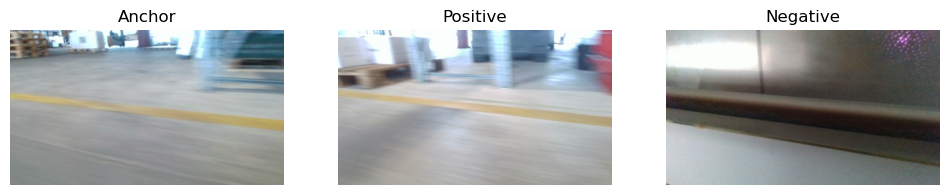

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920095_r.jpg`  
**Positive:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895858_r.jpg`  
**Negative:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921810_r.jpg`

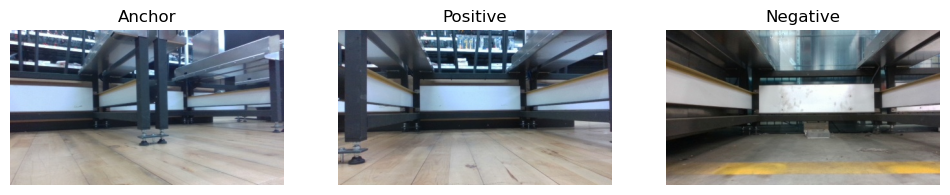

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920156_f.jpg`  
**Positive:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747904050_f.jpg`  
**Negative:** `task_32e918ee-c6c1-4b59-b744-e77f9649b964/1747897085_f.jpg`

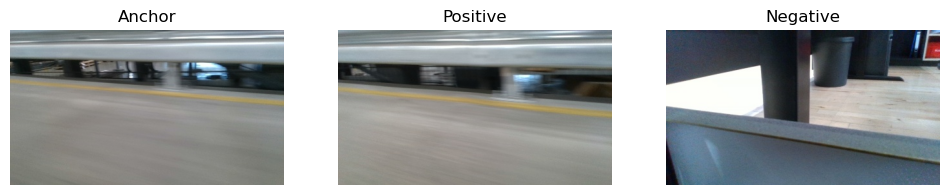

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920086_r.jpg`  
**Positive:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897551_r.jpg`  
**Negative:** `task_32e918ee-c6c1-4b59-b744-e77f9649b964/1747896979_r.jpg`

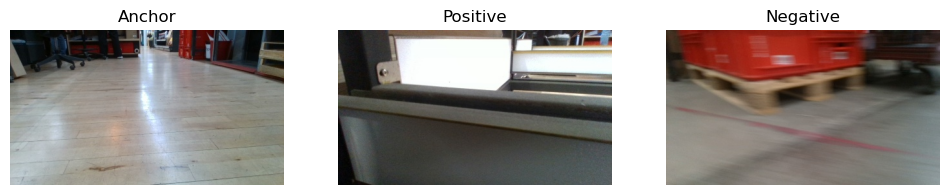

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920156_r.jpg`  
**Positive:** `task_0ccc18af-4c07-422c-b46f-388ccad3d92e/1747919638_r.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913726_r.jpg`

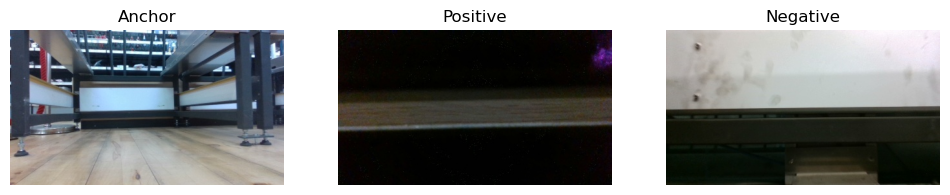

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920159_f.jpg`  
**Positive:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925282_f.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910208_f.jpg`

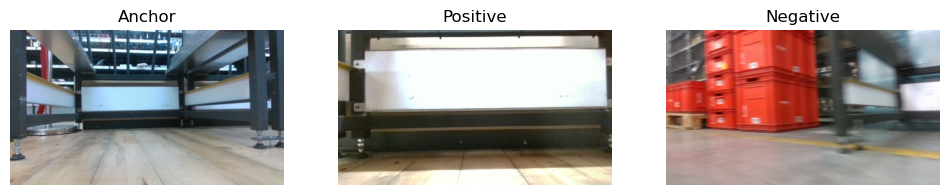

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920144_f.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897676_f.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913677_f.jpg`

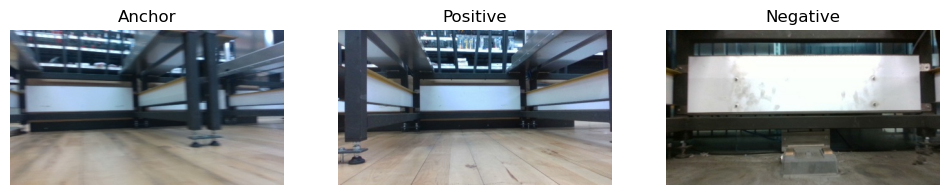

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920137_f.jpg`  
**Positive:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747904052_f.jpg`  
**Negative:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897774_f.jpg`

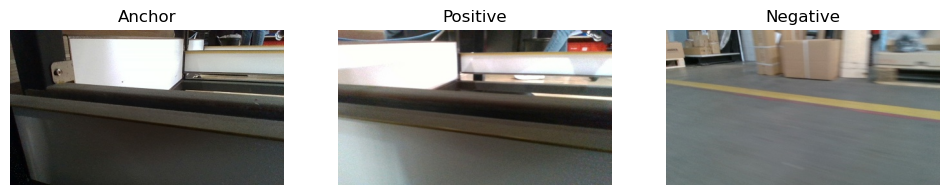

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920177_r.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897673_r.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913834_r.jpg`

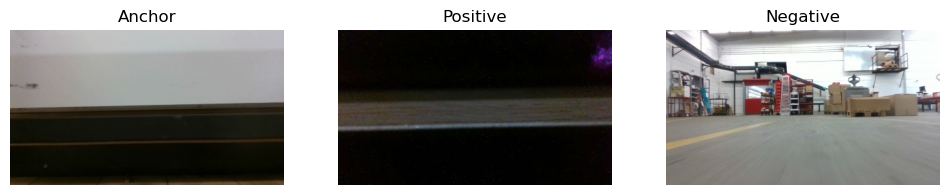

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920171_f.jpg`  
**Positive:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925289_f.jpg`  
**Negative:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925221_f.jpg`

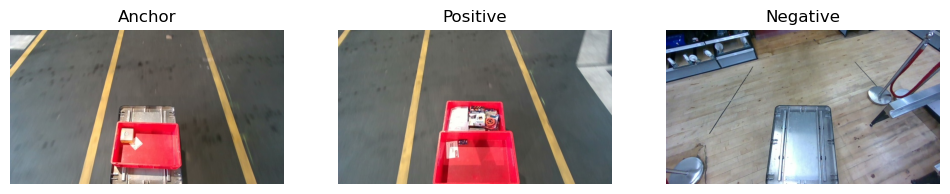

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920100_t.jpg`  
**Positive:** `task_b62fe242-ccb6-4741-8ae1-3aed5fd5ec9e/1747920641_t.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913815_t.jpg`

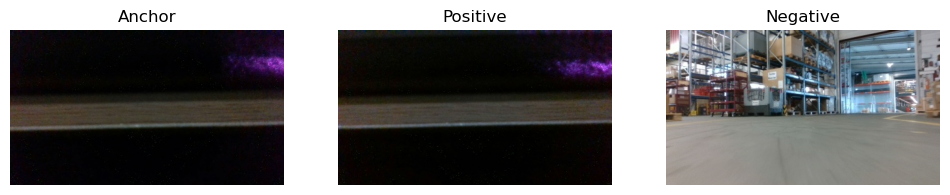

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920178_f.jpg`  
**Positive:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747921959_f.jpg`  
**Negative:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922753_f.jpg`

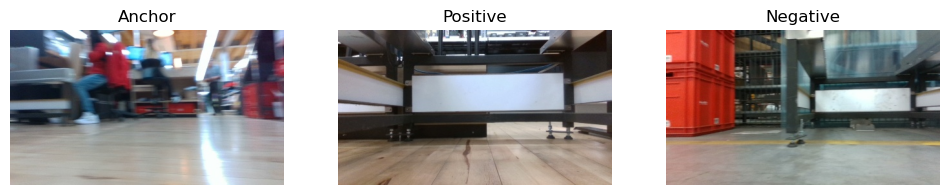

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920134_f.jpg`  
**Positive:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895969_f.jpg`  
**Negative:** `task_0ccc18af-4c07-422c-b46f-388ccad3d92e/1747919724_f.jpg`

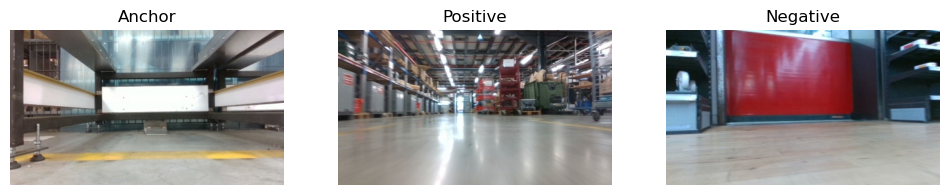

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920065_f.jpg`  
**Positive:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747922038_f.jpg`  
**Negative:** `task_0ccc18af-4c07-422c-b46f-388ccad3d92e/1747919655_f.jpg`

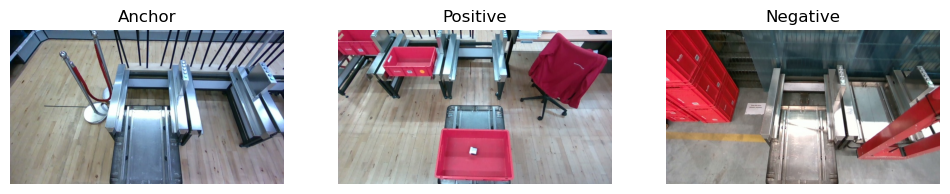

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920169_t.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747910071_t.jpg`  
**Negative:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922809_t.jpg`

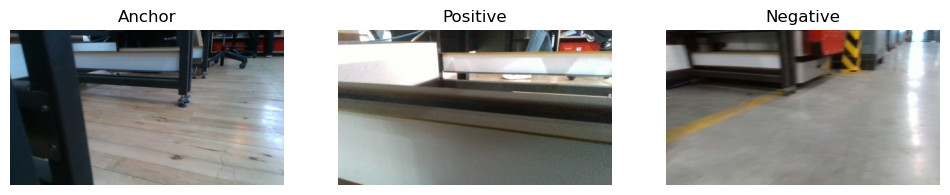

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920166_r.jpg`  
**Positive:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897674_r.jpg`  
**Negative:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909961_r.jpg`

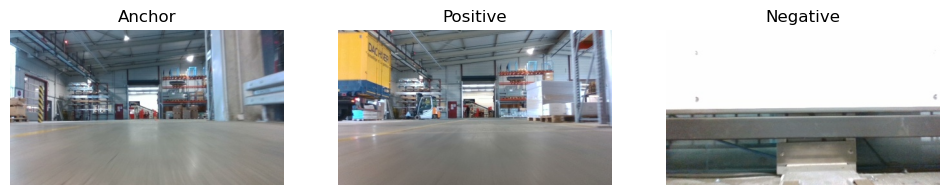

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920092_f.jpg`  
**Positive:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895856_f.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913657_f.jpg`

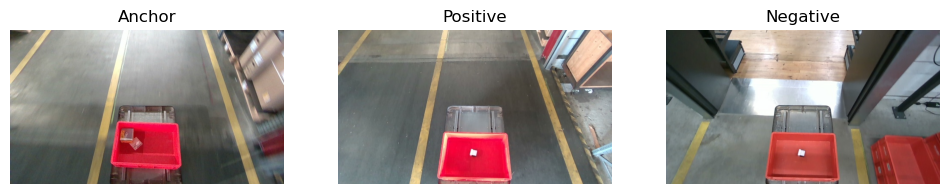

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920107_t.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747910007_t.jpg`  
**Negative:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747910035_t.jpg`

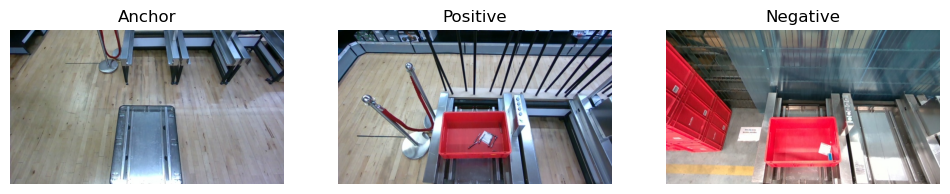

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920161_t.jpg`  
**Positive:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747921952_t.jpg`  
**Negative:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922579_t.jpg`

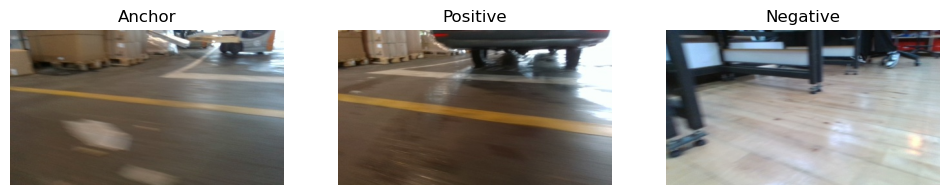

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920103_r.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921862_r.jpg`  
**Negative:** `task_5fa872b7-c2c6-442f-a895-ef7404f93d04/1747925318_r.jpg`

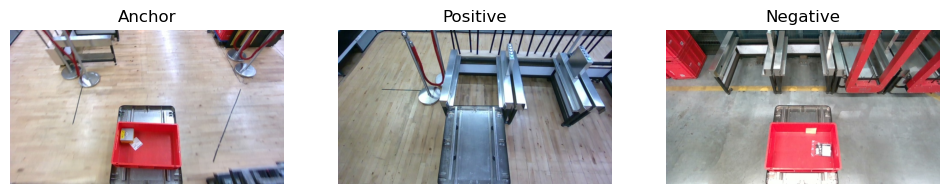

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920129_t.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919609_t.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919502_t.jpg`

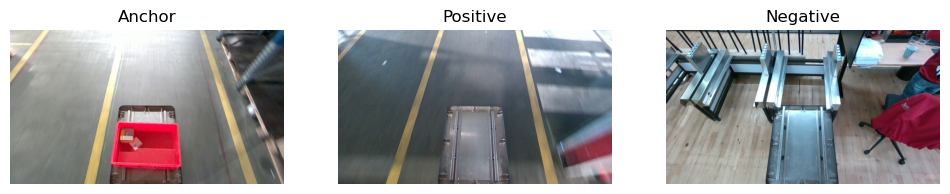

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920108_t.jpg`  
**Positive:** `task_0ccc18af-4c07-422c-b46f-388ccad3d92e/1747919679_t.jpg`  
**Negative:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895970_t.jpg`

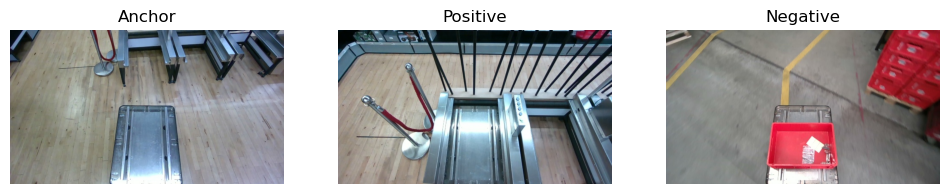

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920160_t.jpg`  
**Positive:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913794_t.jpg`  
**Negative:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747904013_t.jpg`

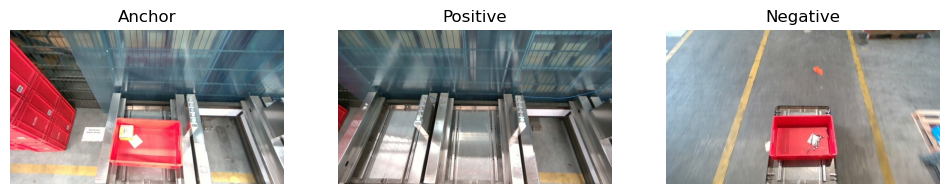

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920041_t.jpg`  
**Positive:** `task_bb4203bd-524f-45de-bdbc-2d7f46ba7e09/1747904192_t.jpg`  
**Negative:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921855_t.jpg`

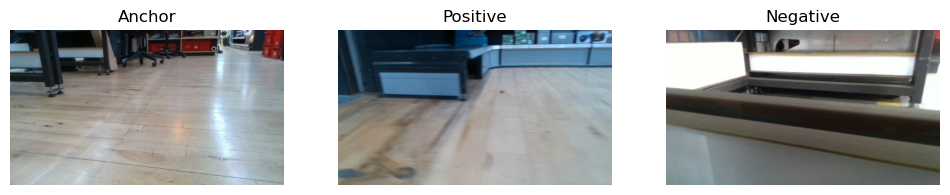

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920145_r.jpg`  
**Positive:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910124_r.jpg`  
**Negative:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747903946_r.jpg`

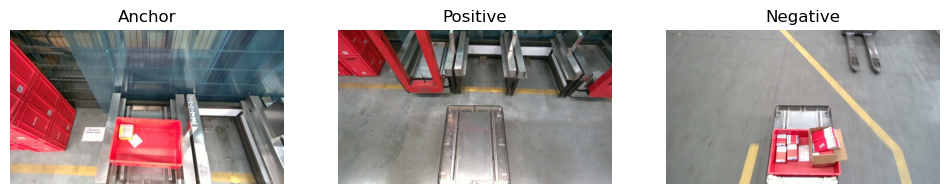

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920047_t.jpg`  
**Positive:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913887_t.jpg`  
**Negative:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897580_t.jpg`

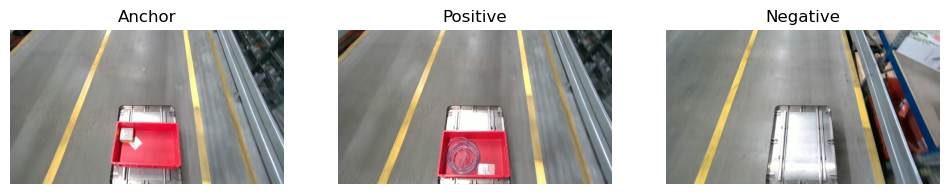

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920081_t.jpg`  
**Positive:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895843_t.jpg`  
**Negative:** `task_bb4ac5f7-2332-4d54-8ef9-60042d3e510b/1747922025_t.jpg`

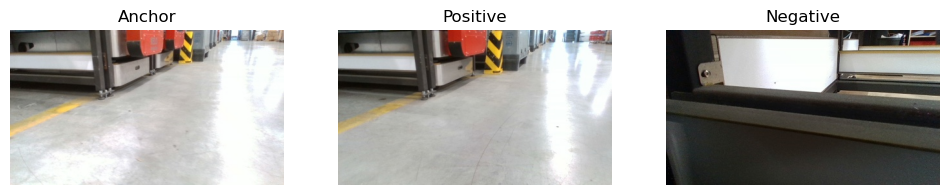

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920059_r.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909953_r.jpg`  
**Negative:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925281_r.jpg`

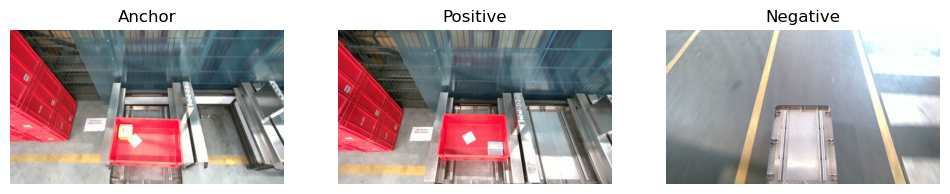

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920050_t.jpg`  
**Positive:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925144_t.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913840_t.jpg`

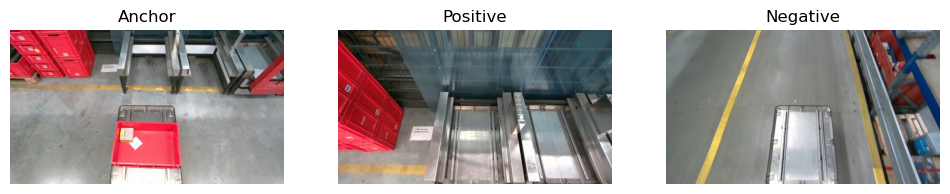

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920068_t.jpg`  
**Positive:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922813_t.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913861_t.jpg`

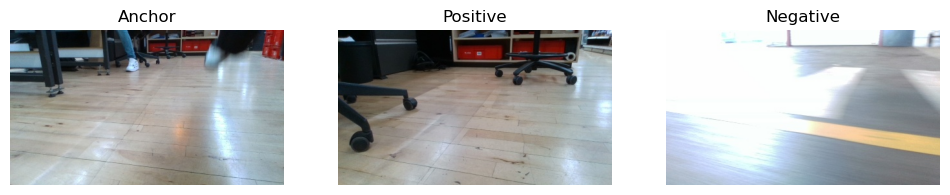

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920139_r.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747910068_r.jpg`  
**Negative:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922765_r.jpg`

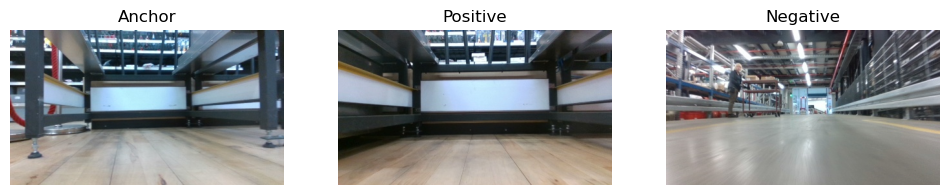

**Anchor:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920149_f.jpg`  
**Positive:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897641_f.jpg`  
**Negative:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747903974_f.jpg`

In [15]:
### Ground truth visualization ***********************************************************

triplets = []
with open(gt_path, 'r') as f:
    for i, line in enumerate(f):
        if not line.strip() or line.startswith("anchor"):
            continue
        if i >= 100:
            break
        anchor, positive, negative = line.strip().split()
        triplets.append((anchor, positive, negative))

for idx, (anchor, positive, negative) in enumerate(triplets):
    fig, axes = plt.subplots(1, 3, figsize=(12, 3))
    for j, img_path in enumerate([anchor, positive, negative]):
        ax = axes[j]
        full_path = os.path.join(dataset_root, img_path)
        img = mpimg.imread(full_path)
        ax.imshow(img)
        ax.axis('off')
        if j == 0:
            ax.set_title("Anchor")
        elif j == 1:
            ax.set_title("Positive")
        else:
            ax.set_title("Negative")
    plt.show()

    display(Markdown(
        f"**Anchor:** `{anchor}`  \n"
        f"**Positive:** `{positive}`  \n"
        f"**Negative:** `{negative}`"
    ))